## Двойной маятник

![double_pendulum](double_pendulum.jpeg)

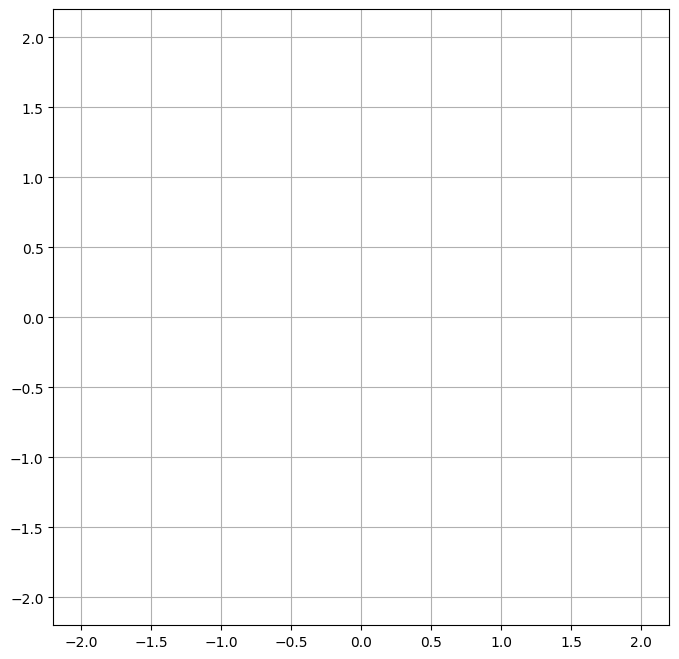

interactive(children=(FloatSlider(value=1.0, description='L1 (m):', max=2.0, min=0.5), FloatSlider(value=1.0, …

Animation size has reached 21000612 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


KeyboardInterrupt: 

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from ipywidgets import interact, FloatSlider, Layout

# Параметры системы по умолчанию
class DoublePendulum:
    def __init__(self):
        self.L1 = 1.0       # Длина первого стержня
        self.L2 = 1.0       # Длина второго стержня
        self.m1 = 1.0       # Масса первого груза
        self.m2 = 1.0       # Масса второго груза
        self.g = 9.81      # Ускорение свободного падения
        self.theta1 = np.pi/2  # Начальный угол первого маятника
        self.theta2 = np.pi/2  # Начальный угол второго маятника
        self.dt = 0.02      # Шаг времени
        self.trajectory_length = 100  # Длина отображаемой траектории
        
    def equations(self, state):
        """Система дифференциальных уравнений"""
        t1, w1, t2, w2 = state
        a = self.m2*self.L1*(w1**2)*np.sin(t1 - t2)*np.cos(t1 - t2)
        b = (self.m1 + self.m2)*self.g*np.sin(t1)
        c = self.m2*self.L2*(w2**2)*np.sin(t1 - t2)
        d = self.m2*self.g*np.sin(t2)*np.cos(t1 - t2)
        
        denominator = (self.m1 + self.m2)*self.L1 - self.m2*self.L1*(np.cos(t1 - t2)**2)
        
        dw1 = (a + b + c - d) / denominator
        dw2 = (self.L1/self.L2)*(dw1*np.cos(t1 - t2) - w1**2*np.sin(t1 - t2)) + (self.g/self.L2)*np.sin(t2)
        
        return [w1, dw1, w2, dw2]

    def energy(self, state):
        """Полная механическая энергия системы"""
        t1, w1, t2, w2 = state
        V = -(self.m1 + self.m2)*self.g*self.L1*np.cos(t1) - self.m2*self.g*self.L2*np.cos(t2)
        T = 0.5*self.m1*(self.L1*w1)**2 + 0.5*self.m2*(
            (self.L1*w1)**2 + (self.L2*w2)**2 + 2*self.L1*self.L2*w1*w2*np.cos(t1 - t2))
        return T + V

# Инициализация фигуры
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, aspect='equal', xlim=(-2.2, 2.2), ylim=(-2.2, 2.2))
ax.grid()

# Элементы анимации
pendulum_line, = ax.plot([], [], 'o-', lw=2, color='black')
trajectory, = ax.plot([], [], '-', lw=1, color='red')
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)
energy_text = ax.text(0.02, 0.90, '', transform=ax.transAxes)

# Инициализация модели
dp = DoublePendulum()
state = [dp.theta1, 0.0, dp.theta2, 0.0]
traj = []

def init():
    pendulum_line.set_data([], [])
    trajectory.set_data([], [])
    return pendulum_line, trajectory, time_text, energy_text

def update(frame):
    global state, traj
    # Интегрирование методом Рунге-Кутты 4 порядка
    k1 = dp.dt * np.array(dp.equations(state))
    k2 = dp.dt * np.array(dp.equations(state + k1/2))
    k3 = dp.dt * np.array(dp.equations(state + k2/2))
    k4 = dp.dt * np.array(dp.equations(state + k3))
    state += (k1 + 2*k2 + 2*k3 + k4)/6
    
    # Обновление позиций
    x1 = dp.L1 * np.sin(state[0])
    y1 = -dp.L1 * np.cos(state[0])
    x2 = x1 + dp.L2 * np.sin(state[2])
    y2 = y1 - dp.L2 * np.cos(state[2])
    
    # Обновление траектории
    traj.append((x2, y2))
    if len(traj) > dp.trajectory_length:
        traj.pop(0)
    
    # Обновление графики
    pendulum_line.set_data([0, x1, x2], [0, y1, y2])
    trajectory.set_data(*zip(*traj))
    time_text.set_text(f'Время: {frame*dp.dt:.2f} с')
    energy_text.set_text(f'Энергия: {dp.energy(state):.2f} Дж')
    
    return pendulum_line, trajectory, time_text, energy_text

# Создание анимации
ani = FuncAnimation(fig, update, frames=2000, init_func=init, blit=True, interval=20)

@interact(
    L1=FloatSlider(value=1.0, min=0.5, max=2.0, step=0.1, description='L1 (m):'),
    L2=FloatSlider(value=1.0, min=0.5, max=2.0, step=0.1, description='L2 (m):'),
    m1=FloatSlider(value=1.0, min=0.1, max=5.0, step=0.1, description='m1 (kg):'),
    m2=FloatSlider(value=1.0, min=0.1, max=5.0, step=0.1, description='m2 (kg):'),
    theta1=FloatSlider(value=90, min=0, max=180, step=1, description='θ1 (deg):'),
    theta2=FloatSlider(value=90, min=0, max=180, step=1, description='θ2 (deg):'),
)
def update_parameters(L1, L2, m1, m2, theta1, theta2):
    dp.L1 = L1
    dp.L2 = L2
    dp.m1 = m1
    dp.m2 = m2
    dp.theta1 = np.deg2rad(theta1)
    dp.theta2 = np.deg2rad(theta2)
    global state, traj
    state = [dp.theta1, 0.0, dp.theta2, 0.0]
    traj = []

# Для отображения в Jupyter Notebook
plt.close()
from IPython.display import HTML
HTML(ani.to_jshtml())

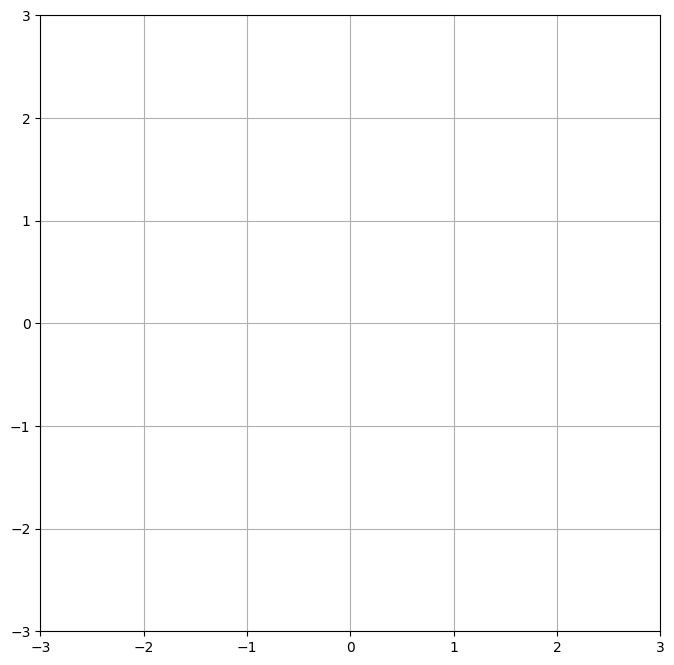

interactive(children=(FloatSlider(value=1.0, description='m1 (kg):', max=5.0, min=0.1), FloatSlider(value=1.5,…

Animation size has reached 21009326 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from ipywidgets import interact, FloatSlider
from scipy.integrate import odeint  # Используем точный решатель ОДУ

# Параметры системы
class DoublePendulum:
    def __init__(self):
        self.L1 = 0.5       # Длина первого стержня
        self.L2 = 1.5       # Длина второго стержня
        self.m1 = 2       # Масса первого груза
        self.m2 = 1.0       # Масса второго груза
        self.g = 9.81       # Ускорение свободного падения
        self.theta1 = np.pi/2  # Начальный угол (радианы)
        self.theta2 = np.pi/2
        self.dt = 0.02      # Шаг времени
        self.state = np.array([self.theta1, 0, self.theta2, 0])  # [θ1, ω1, θ2, ω2]
        
    def equations(self, y, t):
        """Система дифференциальных уравнений"""
        theta1, omega1, theta2, omega2 = y
        delta = theta2 - theta1
        
        # Мои ур-ния движения
        denom = (self.m1 + self.m2 - self.m2*np.cos(delta)**2)
        domega1 = ((self.m2 * self.L1 * omega1**2 * np.sin(delta) * np.cos(delta)
                   + self.m2 * self.g * np.sin(theta2) * np.cos(delta) + 
                   self.m2 * self.L2 * omega2**2 * np.sin(delta) - (self.m1 + self.m2)*self.g*np.sin(theta1))
                    / (self.L1 * denom))
        domega2 = ((-self.m2 * self.L2 * omega2**2 * np.sin(delta) * np.cos(delta)
                   + (self.m2 + self.m2)*(self.g * np.sin(theta1) * np.cos(delta)
                    - self.L1 * omega1**2 * np.sin(delta) - self.g*np.sin(theta2)))
                    / (self.L2 * denom))

        # Уравнения движения (исправленные!)
        # denom = (2*self.m1 + self.m2 - self.m2*np.cos(2*delta))
        # domega1 = (self.m2*self.g*np.sin(theta2)*np.cos(delta) 
                #    - self.m2*np.sin(delta)*(self.L1*omega1**2*np.cos(delta) + self.L2*omega2**2) 
                #    - (2*self.m1 + self.m2)*self.g*np.sin(theta1)) / (self.L1 * denom)
        
        # domega2 = (2*np.sin(delta)*((self.m1 + self.m2)*self.g*np.cos(theta1) 
                #    + self.L2*self.m2*omega2**2*np.cos(delta)) 
                #    - 2*(self.m1 + self.m2)*self.g*np.sin(theta2)) / (self.L2 * denom)
        
        return [omega1, domega1, omega2, domega2]

# Инициализация фигуры
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.grid()

# Элементы анимации
pendulum_line, = ax.plot([], [], 'o-', lw=2, color='black')
trajectory, = ax.plot([], [], '-', lw=1, color='red', alpha=0.5)
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

# Инициализация модели
dp = DoublePendulum()
traj_x, traj_y = [], []

def init():
    pendulum_line.set_data([], [])
    trajectory.set_data([], [])
    time_text.set_text('')
    return pendulum_line, trajectory, time_text

def update(frame):
    global dp, traj_x, traj_y
    # Интегрирование уравнений
    t = np.linspace(0, dp.dt, 2)
    sol = odeint(dp.equations, dp.state, t)
    dp.state = sol[-1]
    
    # Координаты маятника
    x1 = dp.L1 * np.sin(dp.state[0])
    y1 = -dp.L1 * np.cos(dp.state[0])
    x2 = x1 + dp.L2 * np.sin(dp.state[2])
    y2 = y1 - dp.L2 * np.cos(dp.state[2])
    
    # Обновление траектории
    traj_x.append(x2)
    traj_y.append(y2)
    if len(traj_x) > 500:
        traj_x.pop(0)
        traj_y.pop(0)
    
    # Обновление графики
    pendulum_line.set_data([0, x1, x2], [0, y1, y2])
    trajectory.set_data(traj_x, traj_y)
    time_text.set_text(f'Время: {frame * dp.dt:.2f} с')
    return pendulum_line, trajectory, time_text

# Создание анимации
ani = FuncAnimation(fig, update, frames=1000, init_func=init, blit=True, interval=20)

@interact(
    L1=FloatSlider(value=1.0, min=0.1, max=5.0, step=0.1, description='m1 (kg):'),
    L2=FloatSlider(value=1.5, min=0.1, max=5.0, step=0.1, description='m2 (kg):'),
    theta1_deg=FloatSlider(value=145, min=0, max=180, step=1, description='θ1 (deg):'),
    theta2_deg=FloatSlider(value=90, min=0, max=180, step=1, description='θ2 (deg):'),
)
def update_params(L1, L2, theta1_deg, theta2_deg):
    global dp, traj_x, traj_y
    dp.L1 = L1
    dp.L2 = L2
    dp.state[0] = np.deg2rad(theta1_deg)
    dp.state[2] = np.deg2rad(theta2_deg)
    traj_x.clear()
    traj_y.clear()
    ani.event_source.stop()  # Останавливаем текущую анимацию
    ani.event_source.start()  # Перезапускаем с новыми параметрами

# Для отображения в Jupyter
plt.close()
from IPython.display import HTML
HTML(ani.to_jshtml())

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from ipywidgets import FloatSlider, Button, VBox, Output
from scipy.integrate import odeint
from IPython.display import display, HTML

class DoublePendulum:
    def __init__(self):
        self.L1 = 0.5       # Длина первого стержня
        self.L2 = 1.5       # Длина второго стержня
        self.m1 = 2         # Масса первого груза
        self.m2 = 1.0       # Масса второго груза
        self.g = 9.81       # Ускорение свободного падения
        self.dt = 0.02      # Шаг времени
        self.state = np.array([np.pi/2, 0, np.pi/2, 0])  # [θ1, ω1, θ2, ω2]
        
    def equations(self, y, t):
        theta1, omega1, theta2, omega2 = y
        delta = theta2 - theta1
        
        denom = (self.m1 + self.m2 - self.m2*np.cos(delta)**2)
        domega1 = ((self.m2 * self.L1 * omega1**2 * np.sin(delta) * np.cos(delta)
                   + self.m2 * self.g * np.sin(theta2) * np.cos(delta) + 
                   self.m2 * self.L2 * omega2**2 * np.sin(delta) - (self.m1 + self.m2)*self.g*np.sin(theta1))
                    / (self.L1 * denom))
        domega2 = ((-self.m2 * self.L2 * omega2**2 * np.sin(delta) * np.cos(delta)
                   + (self.m2 + self.m2)*(self.g * np.sin(theta1) * np.cos(delta)
                    - self.L1 * omega1**2 * np.sin(delta) - self.g*np.sin(theta2)))
                    / (self.L2 * denom))

        return [omega1, domega1, omega2, domega2]

# Инициализация фигуры
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.grid()

pendulum_line, = ax.plot([], [], 'o-', lw=2, color='black')
trajectory, = ax.plot([], [], '-', lw=1, color='red', alpha=0.5)
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

dp = DoublePendulum()
traj_x, traj_y = [], []

def init():
    pendulum_line.set_data([], [])
    trajectory.set_data([], [])
    time_text.set_text('')
    return pendulum_line, trajectory, time_text

def update(frame):
    global dp, traj_x, traj_y
    t = np.linspace(0, dp.dt, 2)
    sol = odeint(dp.equations, dp.state, t)
    dp.state = sol[-1]
    
    x1 = dp.L1 * np.sin(dp.state[0])
    y1 = -dp.L1 * np.cos(dp.state[0])
    x2 = x1 + dp.L2 * np.sin(dp.state[2])
    y2 = y1 - dp.L2 * np.cos(dp.state[2])
    
    traj_x.append(x2)
    traj_y.append(y2)
    if len(traj_x) > 500:
        traj_x.pop(0)
        traj_y.pop(0)
    
    pendulum_line.set_data([0, x1, x2], [0, y1, y2])
    trajectory.set_data(traj_x, traj_y)
    time_text.set_text(f'Время: {frame * dp.dt:.2f} с')
    return pendulum_line, trajectory, time_text

# Создание виджетов
L1_slider = FloatSlider(value=0.5, min=0.1, max=5.0, step=0.1, description='L1 (m):')
L2_slider = FloatSlider(value=1.5, min=0.1, max=5.0, step=0.1, description='L2 (m):')
theta1_slider = FloatSlider(value=90, min=0, max=180, step=1, description='θ1 (deg):')
theta2_slider = FloatSlider(value=90, min=0, max=180, step=1, description='θ2 (deg):')
start_button = Button(description='Запуск')
output = Output()

controls = VBox([L1_slider, L2_slider, theta1_slider, theta2_slider, start_button])
display(VBox([controls, output]))

def on_start_clicked(b):
    with output:
        output.clear_output(wait=True)
        dp.L1 = L1_slider.value
        dp.L2 = L2_slider.value
        dp.state = [
            np.deg2rad(theta1_slider.value),
            0,
            np.deg2rad(theta2_slider.value),
            0
        ]
        traj_x.clear()
        traj_y.clear()
        ani = FuncAnimation(fig, update, frames=1000, init_func=init, blit=True, interval=20)
        display(HTML(ani.to_jshtml()))

start_button.on_click(on_start_clicked)

plt.close(fig)

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from scipy.integrate import odeint

# Настройка matplotlib для работы без GUI
plt.switch_backend('Agg')

class DoublePendulum:
    def __init__(self, L1=1.0, L2=1.5, theta1=90, theta2=90):
        self.L1 = L1
        self.L2 = L2
        self.m1 = 2.0
        self.m2 = 1.0
        self.g = 9.81
        self.dt = 0.02
        self.state = np.array([
            np.deg2rad(theta1), 
            0, 
            np.deg2rad(theta2), 
            0
        ])

    def equations(self, y, t):
        theta1, omega1, theta2, omega2 = y
        delta = theta2 - theta1
        
        denom = (self.m1 + self.m2 - self.m2*np.cos(delta)**2)
        domega1 = ((self.m2 * self.L1 * omega1**2 * np.sin(delta) * np.cos(delta)
                   + self.m2 * self.g * np.sin(theta2) * np.cos(delta) + 
                   self.m2 * self.L2 * omega2**2 * np.sin(delta) - (self.m1 + self.m2)*self.g*np.sin(theta1))
                    / (self.L1 * denom))
        domega2 = ((-self.m2 * self.L2 * omega2**2 * np.sin(delta) * np.cos(delta)
                   + (self.m2 + self.m2)*(self.g * np.sin(theta1) * np.cos(delta)
                    - self.L1 * omega1**2 * np.sin(delta) - self.g*np.sin(theta2)))
                    / (self.L2 * denom))

        return [omega1, domega1, omega2, domega2]

def create_animation(L1=1.0, L2=1.5, theta1=90, theta2=90, filename='pendulum_animation.mp4'):
    # Инициализация модели
    dp = DoublePendulum(L1, L2, theta1, theta2)
    
    # Создание фигуры
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    ax.grid()
    
    # Инициализация элементов анимации
    pendulum_line, = ax.plot([], [], 'o-', lw=2, color='black')
    trajectory, = ax.plot([], [], '-', lw=1, color='red', alpha=0.5)
    time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)
    traj_x, traj_y = [], []

    def init():
        pendulum_line.set_data([], [])
        trajectory.set_data([], [])
        time_text.set_text('')
        return pendulum_line, trajectory, time_text

    def update(frame):
        nonlocal dp, traj_x, traj_y
        t = np.linspace(0, dp.dt, 2)
        sol = odeint(dp.equations, dp.state, t)
        dp.state = sol[-1]
        
        x1 = dp.L1 * np.sin(dp.state[0])
        y1 = -dp.L1 * np.cos(dp.state[0])
        x2 = x1 + dp.L2 * np.sin(dp.state[2])
        y2 = y1 - dp.L2 * np.cos(dp.state[2])
        
        traj_x.append(x2)
        traj_y.append(y2)
        if len(traj_x) > 500:
            traj_x.pop(0)
            traj_y.pop(0)
        
        pendulum_line.set_data([0, x1, x2], [0, y1, y2])
        trajectory.set_data(traj_x, traj_y)
        time_text.set_text(f'Time: {frame * dp.dt:.2f} s')
        return pendulum_line, trajectory, time_text

    # Создание анимации
    ani = FuncAnimation(
        fig, 
        update, 
        frames=1000, 
        init_func=init, 
        blit=True, 
        interval=20
    )
    
    # Настройки для сохранения видео
    writer = FFMpegWriter(fps=30, bitrate=1800)
    ani.save(filename, writer=writer)
    
    # Очистка ресурсов
    plt.close(fig)
    print(f"Animation saved to {filename}")

# Пример использования
create_animation(
    L1=1.0,
    L2=1.5,
    theta1=90,
    theta2=90,
    filename='double_pendulum.mp4'
)

FileNotFoundError: [WinError 2] Не удается найти указанный файл

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from ipywidgets import interact, FloatSlider

def henon_map(points, λ, b):
    """Применяет отображение Эно к массиву точек"""
    x, y = points[:, 0], points[:, 1]
    new_x = 1 - λ * x**2 - b * y
    new_y = x
    return np.column_stack((new_x, new_y))

# Генерация начального облака точек
def generate_cloud(x_range=(-2, 2), y_range=(-2, 2), num=1000):
    x = np.random.uniform(*x_range, num)
    y = np.random.uniform(*y_range, num)
    return np.column_stack((x, y))

# Параметры по умолчанию
params = {'λ': 1.4, 'b': 0.3}
points = generate_cloud()

# Настройка графики
fig, ax = plt.subplots(figsize=(8, 8))
scat = ax.scatter([], [], s=1, c='blue')
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.set_title("Отображение Эно")
ax.grid(True)

def update(frame):
    global points
    points = henon_map(points, params['λ'], params['b'])
    scat.set_offsets(points)
    return scat,

def set_params(λ=1.4, b=0.3):
    global points
    params.update({'λ': λ, 'b': b})
    points = generate_cloud()

anim = FuncAnimation(fig, update, interval=50, blit=True)

@interact(
        # value=1.0, min=0.1, max=5.0, step=0.1, description='m1 (kg):'
    λ=FloatSlider(value=1.4, min=0.1, max=2.0, step=0.1),
    b=FloatSlider(value=0.3, min=0.0, max=0.5, step=0.05)
)
def update_params(λ, b):
    set_params(λ, b)
    display(fig)

# plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_232\1106253861.py:42: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  anim = FuncAnimation(fig, update, interval=50, blit=True)


interactive(children=(FloatSlider(value=1.4, description='λ', max=2.0, min=0.1), FloatSlider(value=0.3, descri…

In [14]:
num = 5
x = np.linspace(-2, 2, num)
y = np.linspace(-2, 2, num)
np.meshgrid(x, y)

(array([[-2., -1.,  0.,  1.,  2.],
        [-2., -1.,  0.,  1.,  2.],
        [-2., -1.,  0.,  1.,  2.],
        [-2., -1.,  0.,  1.,  2.],
        [-2., -1.,  0.,  1.,  2.]]),
 array([[-2., -2., -2., -2., -2.],
        [-1., -1., -1., -1., -1.],
        [ 0.,  0.,  0.,  0.,  0.],
        [ 1.,  1.,  1.,  1.,  1.],
        [ 2.,  2.,  2.,  2.,  2.]]))